## Lesson Notes
---
## First, I'll compute the camera calibration using chessboard images

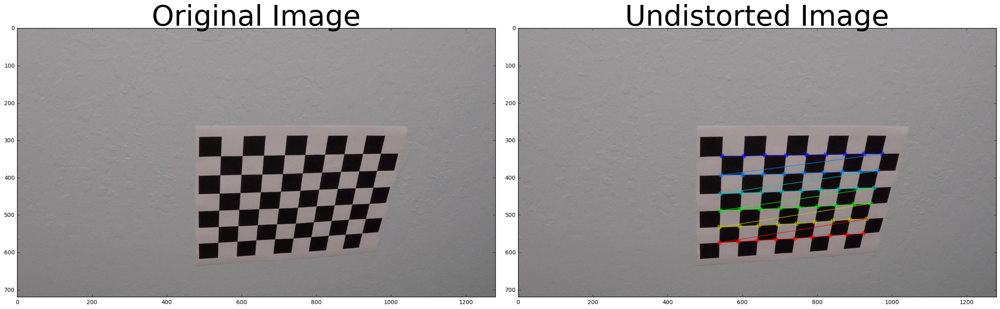

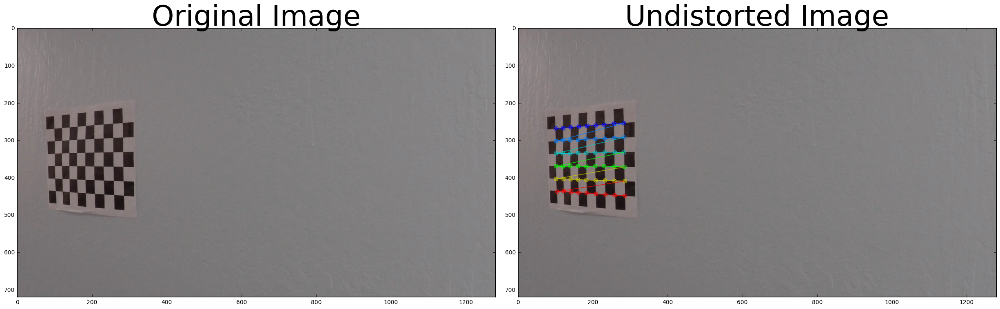

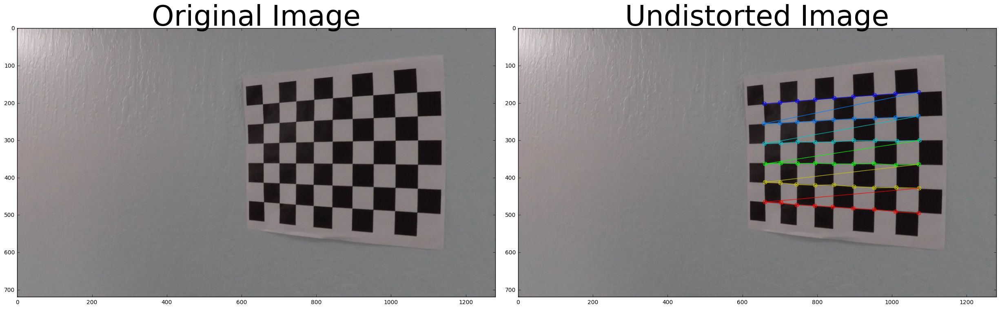

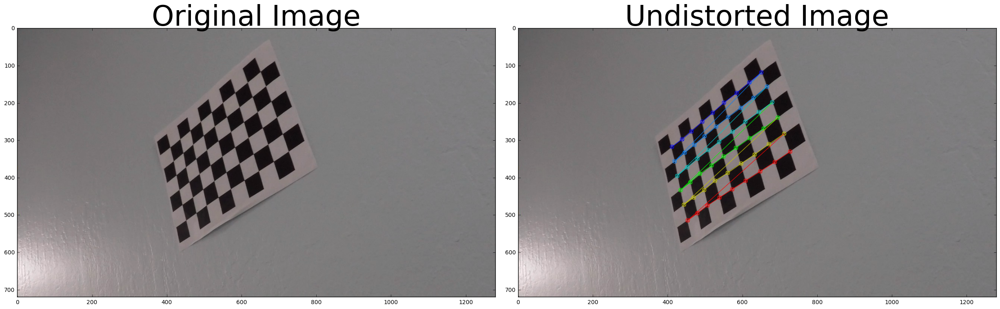

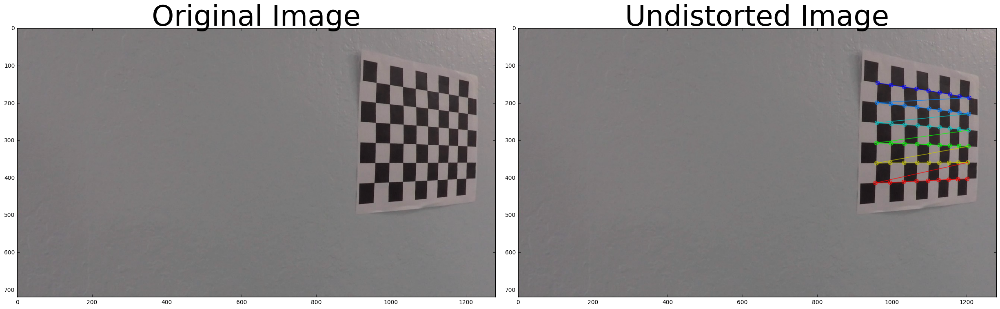

...

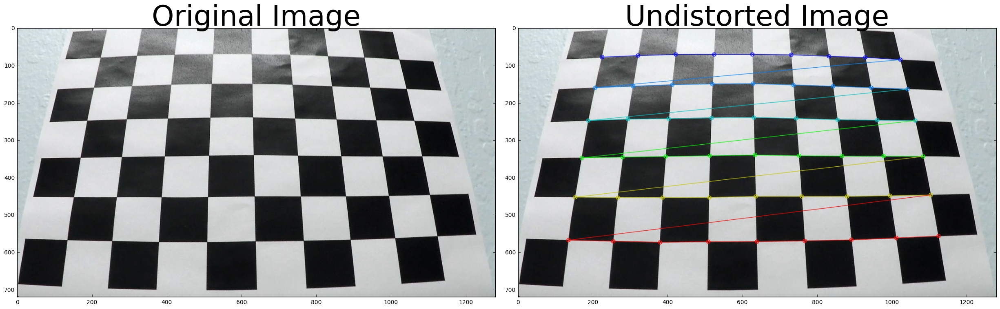

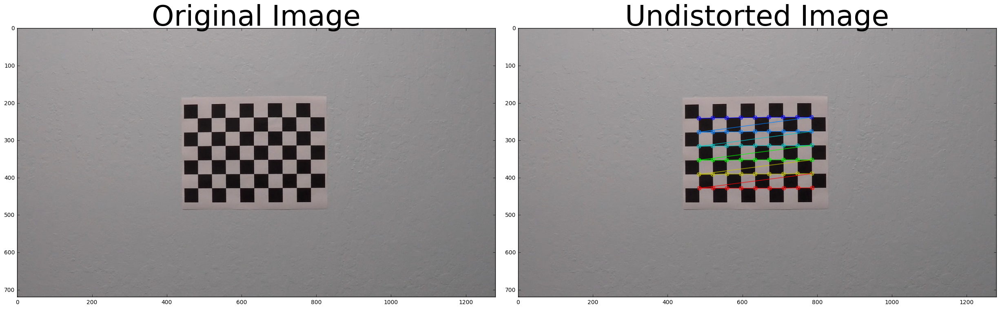

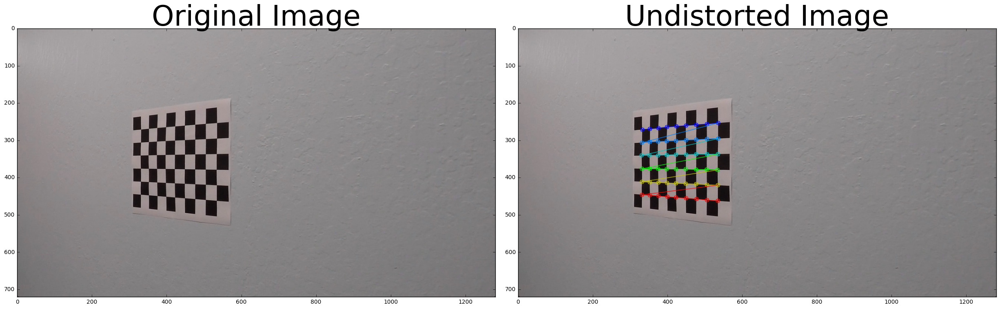

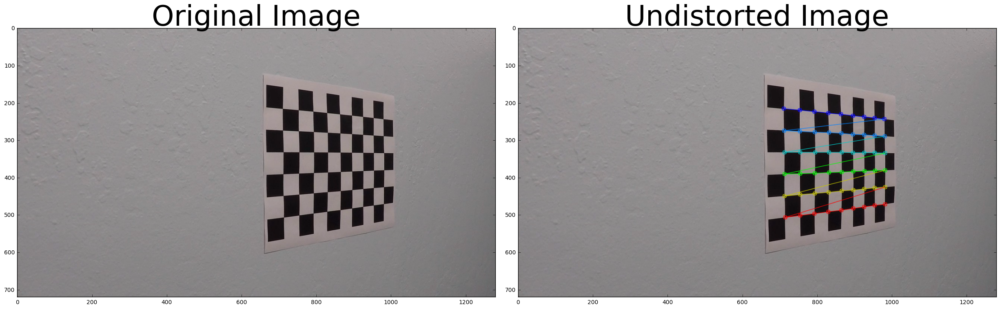

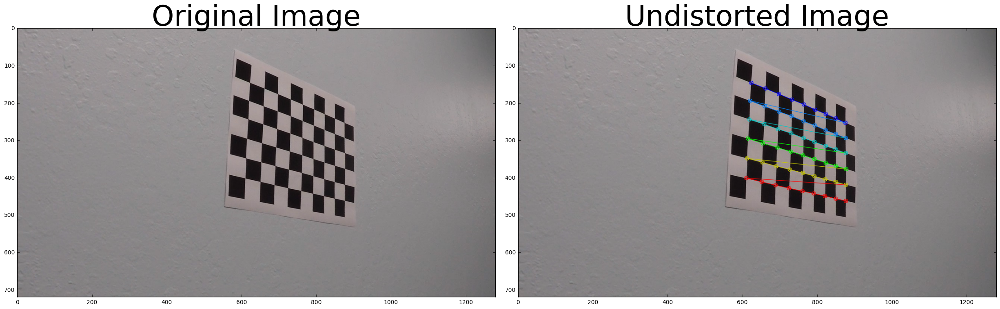

In [55]:
import numpy as np
import cv2
import glob
import matplotlib.image as  mpimg
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=50)
        
        # Draw and display the corners
        crn_img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        ax2.imshow(img)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## Correcting distortion

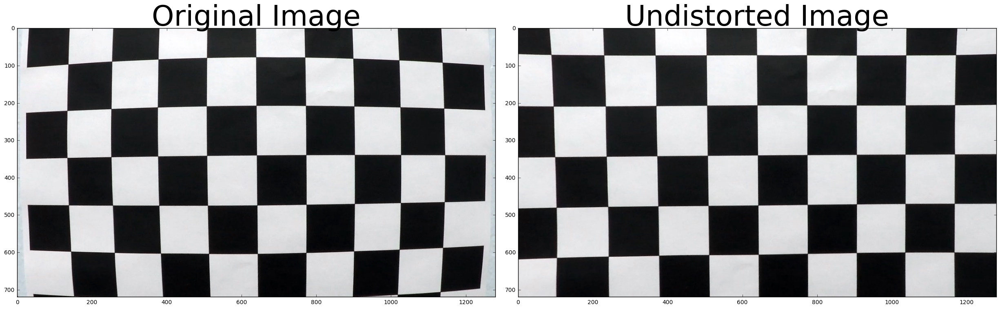

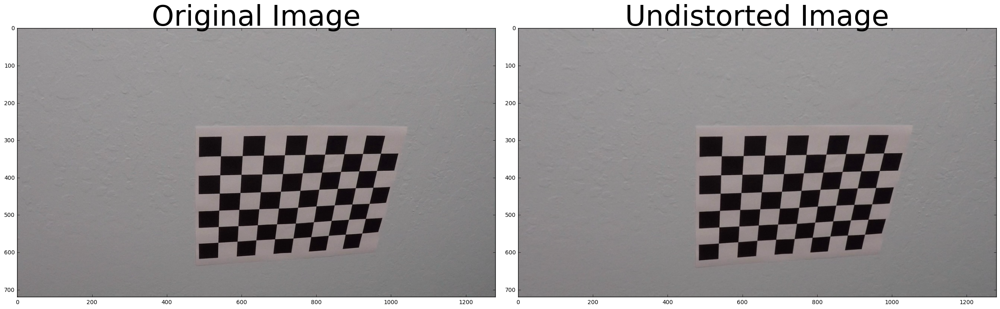

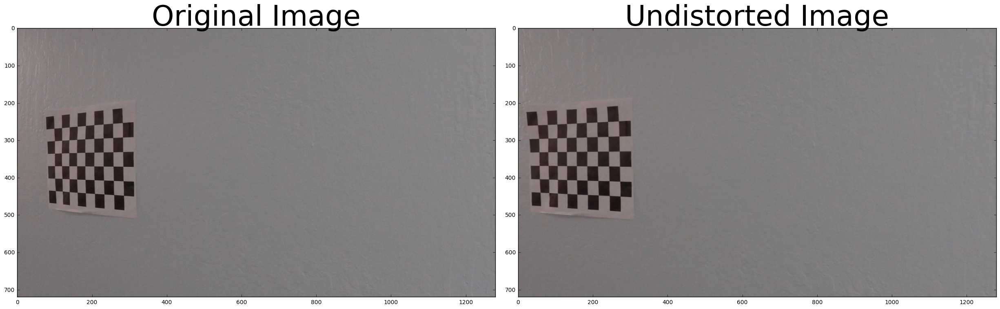

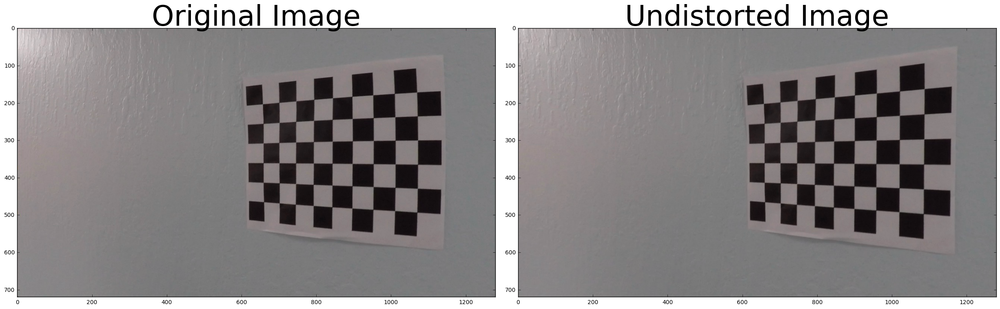

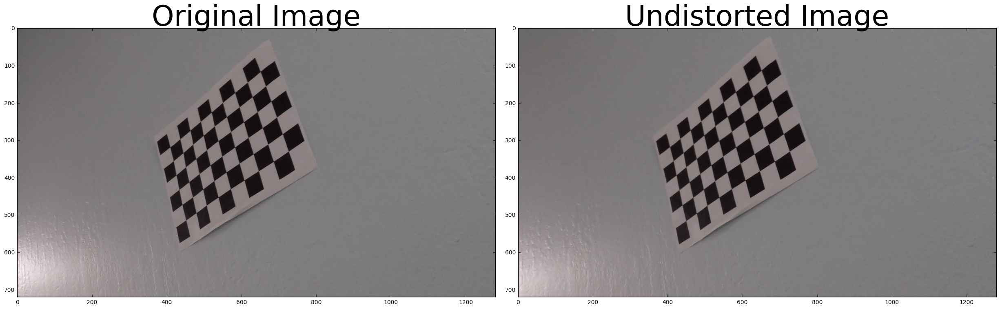

...

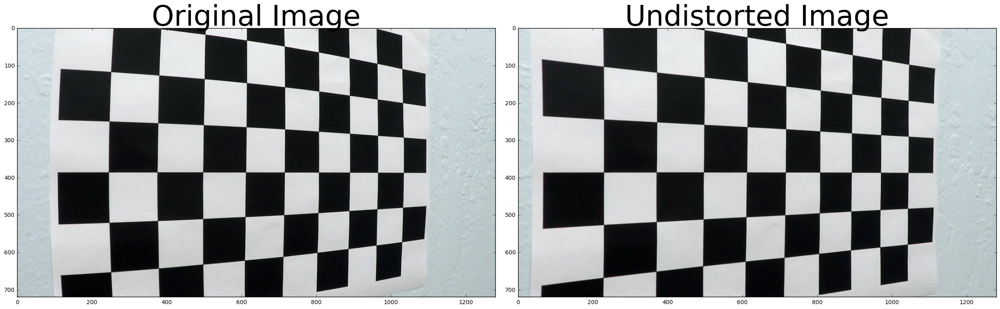

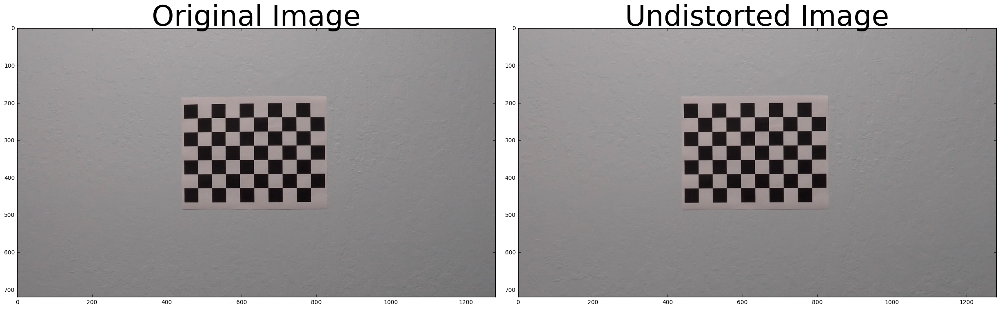

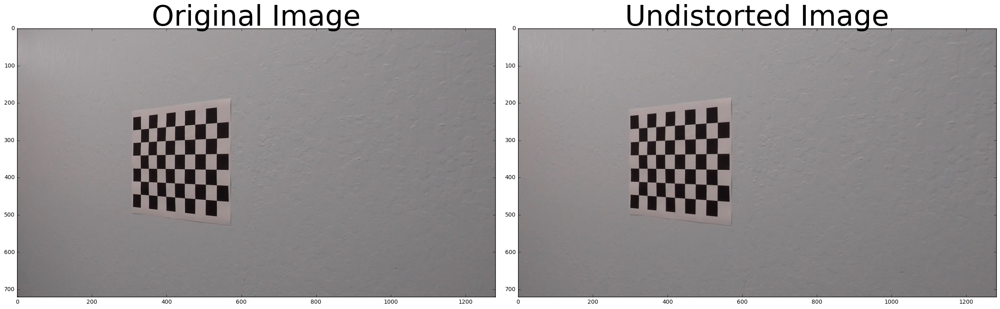

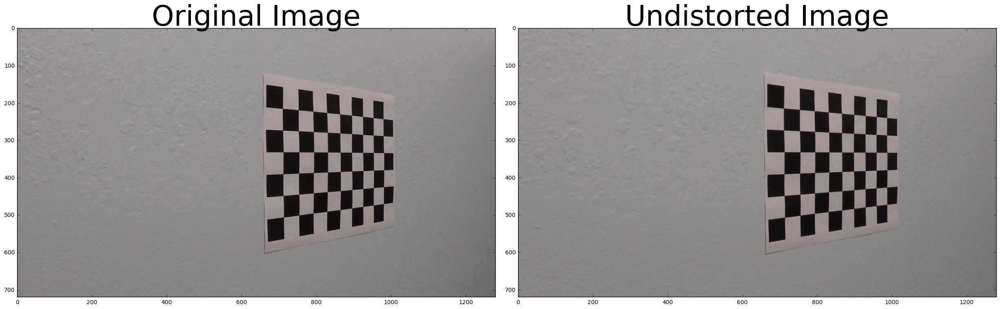

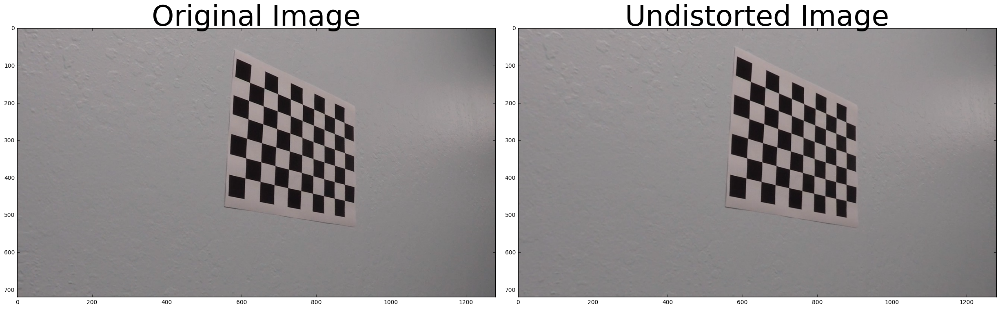

In [8]:
for fname in images:
    # Read in an image
    img = cv2.imread(fname)

    # TODO: Write a function that takes an image, object points, and image points
    # performs the camera calibration, image distortion correction and 
    # returns the undistorted image
    def cal_undistort(img, objpoints, imgpoints):
        # Use cv2.calibrateCamera() and cv2.undistort()
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
            objpoints, imgpoints, gray.shape[::-1], None, None)
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        return undist

    undistorted = cal_undistort(img, objpoints, imgpoints)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Perspective transform

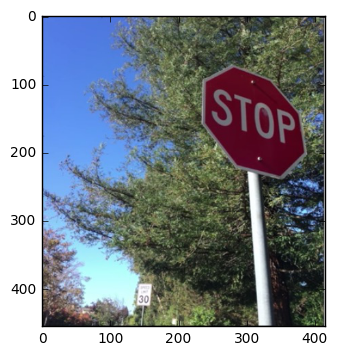

In [5]:
# Get image preview
img = mpimg.imread('./misc_images/stopSign.jpg')

# Display image
plt.imshow(img)

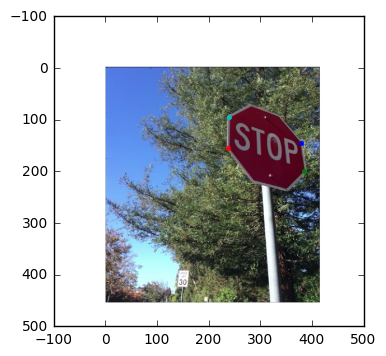

In [43]:
# source image points
plt.imshow(img)

img_pts = [[378, 145], [385, 200], [238, 155], [240, 95]]

# format is in x, y, dot
plt.plot(img_pts[0][0], img_pts[0][1], '.') # top right
plt.plot(img_pts[1][0], img_pts[1][1], '.') # bottom right
plt.plot(img_pts[2][0], img_pts[2][1], '.') # bottom left
plt.plot(img_pts[3][0], img_pts[3][1], '.') # top left

In [52]:
# Define persepective trnaform function
def warp(img):
    
    # Define calibration box in source (original) and destination (desired or waped) coordinates
    img_size = (img.shape[1], img.shape[0])
    
    # Four source coordinates
    src = np.float32(img_pts)
    
    img_sqr = [[387, 100], [387, 165], [225, 165], [225, 100]]
    
    # Four desired coordinates
    dst = np.float32(img_sqr)
    
    # Compute the perspective transform, M
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Could compute the inverse also by swapping the input parameters
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # create warped image - uses linear interpolation
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped

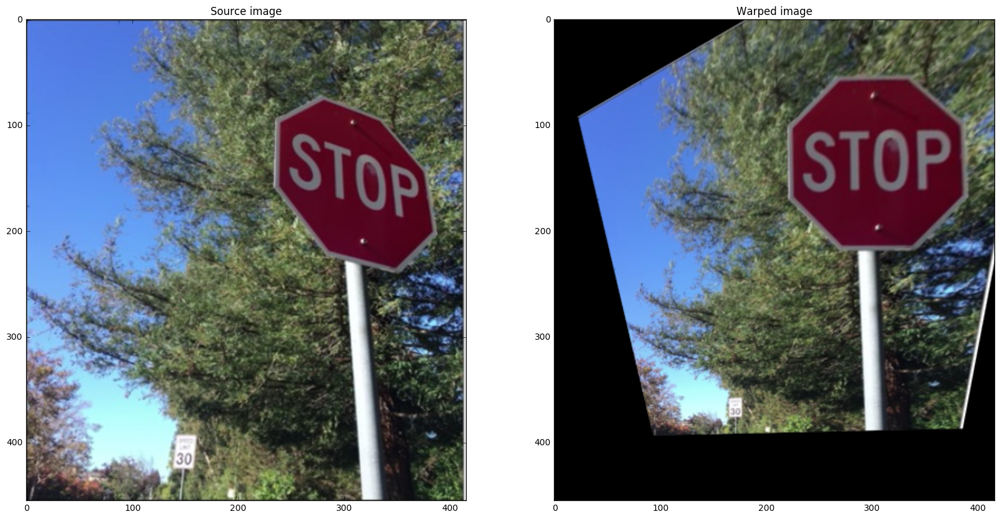

In [53]:
# Get perspective transform
warped_im = warp(img)

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

ax1.set_title('Source image')
ax1.imshow(img)
ax2.set_title('Warped image')
ax2.imshow(warped_im)